In [1]:
import os
import shutil
import warnings

import numpy as np
import pandas as pd
import plotly.graph_objects as go
import torchaudio

warnings.filterwarnings(action="ignore")
from IPython.core.interactiveshell import InteractiveShell

InteractiveShell.ast_node_interactivity = "all"
import json

import geopandas
import librosa
import librosa.display
import matplotlib.pyplot as plt
import scipy.stats as st
import seaborn as sns
import soundfile
import tensorflow as tf
import tensorflow_addons as tfa
import torch

%matplotlib inline
from PIL import Image
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from torchaudio.transforms import MelSpectrogram
from tqdm import tqdm

from src.MEL_Gen import MEL_Gen, Mel_Provider
from src.prepare_dataset import (
    choose_ids,
    make_dict_birds,
    make_intervals,
    make_intervals_upsampling,
    prepare_dataset,
)

In [2]:
SEED = 37
IMG_SIZE = 260
SAMPLE_RATE = 32000
N_FFT = 2048
SIGNAL_LENGTH = 5
FREQ_MIN = 0
FREQ_MAX = 16000
WIN_LENGHT = 1024
BATCH_SIZE = 300
list_drop = [
    "XC509721.ogg",
    "XC428067.ogg",
    "XC523831.ogg",
    "XC523960.ogg",
    "XC237870.ogg",
    "XC129924.ogg",
    "XC576851.ogg",
    "XC579430.ogg",
    "XC590621.ogg",
]

In [3]:
final = pd.read_csv("/app/_data/labels_nocall/nocall_predictions.csv")


In [4]:
all_audio_init = pd.read_csv("/app/_data/all_audio_initial.csv")
all_audio_init = all_audio_init.query("filename not in @list_drop").reset_index(drop=True)
all_audio_init.shape

(65265, 24)

## calls

In [5]:
final = final.merge(
    all_audio_init[["filename", "primary_label",'secondary_labels', 'file_path', 'duration', 'rating']], on="filename", how="left"
)

In [6]:
final.sample(2)

,nocall,bird,row_id,filename,end_sec,primary_label,secondary_labels,file_path,duration,rating
3216954,0,1,XC423219_26_0,XC423219.ogg,26.0,yegvir,NaN,/app/_data/train_short_audio/yegvir/XC423219.ogg,26.136625,5.0
38120,0,1,XC452143_11_0,XC452143.ogg,11.0,amecro,NaN,/app/_data/train_short_audio/amecro/XC452143.ogg,30.054969,3.0


In [7]:
final = final[final['rating']>=3]

In [8]:
final['primary_label'].value_counts().tail(10)

flrtan1    758
crfpar     694
grhcha1    683
rthhum     571
hofwoo1    326
runwre1    288
heptan     283
whcpar     190
stvhum2     90
wegspa1     74
Name: primary_label, dtype: int64

In [9]:
list_birds = final['primary_label'].unique().tolist()

In [30]:
list_birds.index('wegspa1')

352

In [21]:
final[final['primary_label']==list_birds[10]]['filename'].unique()

array(['XC150015.ogg', 'XC150063.ogg', 'XC152396.ogg', 'XC153020.ogg',
       'XC165450.ogg', 'XC172886.ogg', 'XC172887.ogg', 'XC172888.ogg',
       'XC172889.ogg', 'XC172890.ogg', 'XC187408.ogg', 'XC187411.ogg',
       'XC298401.ogg', 'XC379016.ogg', 'XC384955.ogg', 'XC396690.ogg',
       'XC398300.ogg', 'XC403005.ogg', 'XC404504.ogg', 'XC448935.ogg',
       'XC448937.ogg', 'XC509697.ogg', 'XC519618.ogg', 'XC519619.ogg',
       'XC519789.ogg', 'XC524662.ogg', 'XC524663.ogg', 'XC530872.ogg',
       'XC531510.ogg', 'XC603725.ogg', 'XC611348.ogg'], dtype=object)

[nan] 7


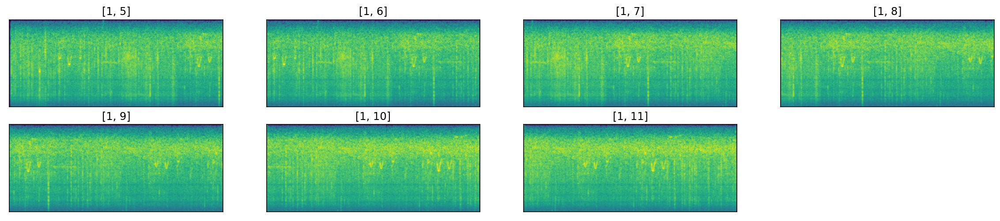

In [34]:
filename = 'XC403005.ogg'
df = final[final['filename']==filename].reset_index(drop=True)
wave = np.load('/app/_data/npy/waves_npy/'+filename[:-4]+'.npy')
print(df['secondary_labels'].unique(), len(df))
n_plots=len(df)
plt.figure(figsize=(20,2*np.ceil(n_plots/4)))
for i in range(len(df)):
    plt.subplot(np.ceil(n_plots/4), 4, i+1)
    end = df.loc[i,'end_sec']
    wave_part= wave[int(32000*(end-5)):int(32000*end)]
    mel = librosa.power_to_db(librosa.feature.melspectrogram(wave_part, sr=32000))
    plt.subplot(np.ceil(n_plots/4), 4, i+1)
    plt.title([df.loc[i,'bird'], int(end)])
    plt.imshow(mel)
    plt.xticks([])
    plt.yticks([])
plt.show();

In [33]:
import IPython.display as ipd
ipd.Audio(wave,rate=32000)

In [80]:
list_birds[10]

'amewig'

In [12]:
path_list = final[(final['duration']>10)&(final['duration']<20)]['filename'].unique()

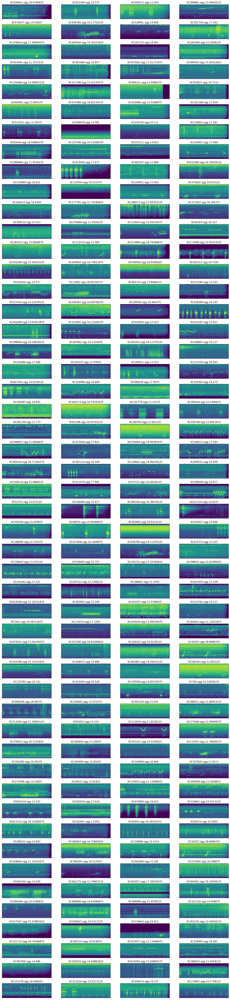

In [13]:
plt.figure(figsize=(20,90))
for i in range(200):
    j = np.random.randint(0, len(path_list)//2)
    k = np.random.randint(0, len(path_list)//2)
    filename = path_list[i+k]
    wave = np.load('/app/_data/npy/waves_npy/'+filename[:-4]+'.npy')
    dur = len(wave)/32000
    plt.subplot(50, 4, i+1)
    wave_part= wave[(len(wave)-32000*7):]
    mel = librosa.power_to_db(librosa.feature.melspectrogram(wave_part, sr=32000))
    plt.title(filename+' '+str(dur))
    plt.imshow(mel)
    plt.xticks([])
    plt.yticks([])
plt.show();
    